## Importing Necessary Libraries

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import joblib
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report

## Retriving and preprocessing the data

In [2]:
data = pd.read_csv("tumor_data.csv")
data.head()

,id,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,...,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst,Unnamed: 32
0,842302,M,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,...,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890,NaN
1,842517,M,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,...,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902,NaN
2,84300903,M,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,...,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758,NaN
3,84348301,M,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,...,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300,NaN
4,84358402,M,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,...,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678,NaN


In [3]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 33 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       569 non-null    int64  
 1   diagnosis                569 non-null    object 
 2   radius_mean              569 non-null    float64
 3   texture_mean             569 non-null    float64
 4   perimeter_mean           569 non-null    float64
 5   area_mean                569 non-null    float64
 6   smoothness_mean          569 non-null    float64
 7   compactness_mean         569 non-null    float64
 8   concavity_mean           569 non-null    float64
 9   concave points_mean      569 non-null    float64
 10  symmetry_mean            569 non-null    float64
 11  fractal_dimension_mean   569 non-null    float64
 12  radius_se                569 non-null    float64
 13  texture_se               569 non-null    float64
 14  perimeter_se             5

In [4]:
# id and Unnamed: 32 is useless for our usecase
data = data.drop(["id", "Unnamed: 32"], axis=1)
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 569 entries, 0 to 568
Data columns (total 31 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   diagnosis                569 non-null    object 
 1   radius_mean              569 non-null    float64
 2   texture_mean             569 non-null    float64
 3   perimeter_mean           569 non-null    float64
 4   area_mean                569 non-null    float64
 5   smoothness_mean          569 non-null    float64
 6   compactness_mean         569 non-null    float64
 7   concavity_mean           569 non-null    float64
 8   concave points_mean      569 non-null    float64
 9   symmetry_mean            569 non-null    float64
 10  fractal_dimension_mean   569 non-null    float64
 11  radius_se                569 non-null    float64
 12  texture_se               569 non-null    float64
 13  perimeter_se             569 non-null    float64
 14  area_se                  5

Here diagnosis is out target data. It has M for malignant and B for benign. I want is as integer value.

In [5]:
pd.set_option('future.no_silent_downcasting', True) # suppress future_warning and enable the future behavior
data["diagnosis"] = data["diagnosis"].replace({"M": 1, "B": 0}).astype(int)
data["diagnosis"]

0      1
1      1
2      1
3      1
4      1
      ..
564    1
565    1
566    1
567    1
568    0
Name: diagnosis, Length: 569, dtype: int64

## Visualize the data and it's relation

In [6]:
data.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,1,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,1,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,1,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,1,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [7]:
data.describe()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
count,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,...,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000,569.000000
mean,0.372583,14.127292,19.289649,91.969033,654.889104,0.096360,0.104341,0.088799,0.048919,0.181162,...,16.269190,25.677223,107.261213,880.583128,0.132369,0.254265,0.272188,0.114606,0.290076,0.083946
std,0.483918,3.524049,4.301036,24.298981,351.914129,0.014064,0.052813,0.079720,0.038803,0.027414,...,4.833242,6.146258,33.602542,569.356993,0.022832,0.157336,0.208624,0.065732,0.061867,0.018061
min,0.000000,6.981000,9.710000,43.790000,143.500000,0.052630,0.019380,0.000000,0.000000,0.106000,...,7.930000,12.020000,50.410000,185.200000,0.071170,0.027290,0.000000,0.000000,0.156500,0.055040
25%,0.000000,11.700000,16.170000,75.170000,420.300000,0.086370,0.064920,0.029560,0.020310,0.161900,...,13.010000,21.080000,84.110000,515.300000,0.116600,0.147200,0.114500,0.064930,0.250400,0.071460
50%,0.000000,13.370000,18.840000,86.240000,551.100000,0.095870,0.092630,0.061540,0.033500,0.179200,...,14.970000,25.410000,97.660000,686.500000,0.131300,0.211900,0.226700,0.099930,0.282200,0.080040
75%,1.000000,15.780000,21.800000,104.100000,782.700000,0.105300,0.130400,0.130700,0.074000,0.195700,...,18.790000,29.720000,125.400000,1084.000000,0.146000,0.339100,0.382900,0.161400,0.317900,0.092080
max,1.000000,28.110000,39.280000,188.500000,2501.000000,0.163400,0.345400,0.426800,0.201200,0.304000,...,36.040000,49.540000,251.200000,4254.000000,0.222600,1.058000,1.252000,0.291000,0.663800,0.207500


In [8]:
sns.pairplot(data, hue='diagnosis')

## This pairplot shows that every data of the feature is able to kind of distinguishing the Melignant and Benign tumor.

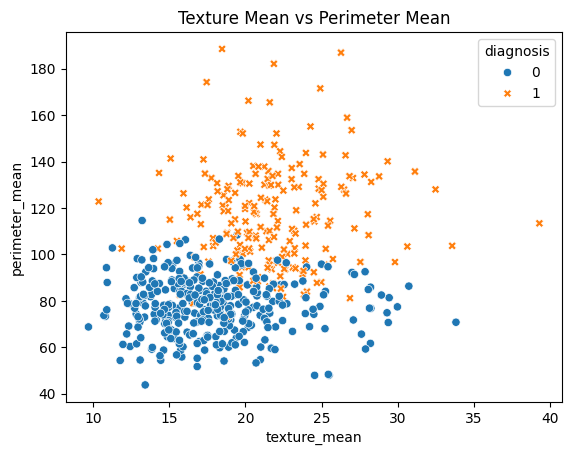

In [9]:
sns.scatterplot(data=data, 
                x='texture_mean', 
                y='perimeter_mean', 
                hue='diagnosis',            # Color by diagnosis
                style='diagnosis',          # Different markers by diagnosis
                markers={1: 'X', 0: 'o'})    # '1' = square (malignant), '0' = X (benign)

plt.title('Texture Mean vs Perimeter Mean')
plt.show()

In [10]:
count_diagnosis = data['diagnosis'].value_counts()

print(count_diagnosis)

diagnosis
0    357
1    212
Name: count, dtype: int64


In [11]:
# Group the data by 'diagnosis' and calculate the mean for each group
mean_values = data.groupby('diagnosis').mean()

mean_values

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
diagnosis,,,,,,,,,,,,,,,,,,,,,
0,12.146524,17.914762,78.075406,462.790196,0.092478,0.080085,0.046058,0.025717,0.174186,0.062867,...,13.379801,23.515070,87.005938,558.899440,0.124959,0.182673,0.166238,0.074444,0.270246,0.079442
1,17.462830,21.604906,115.365377,978.376415,0.102898,0.145188,0.160775,0.087990,0.192909,0.062680,...,21.134811,29.318208,141.370330,1422.286321,0.144845,0.374824,0.450606,0.182237,0.323468,0.091530


## Train the model

In [12]:
data.head()

,diagnosis,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
0,1,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.3001,0.14710,0.2419,...,25.38,17.33,184.60,2019.0,0.1622,0.6656,0.7119,0.2654,0.4601,0.11890
1,1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.0869,0.07017,0.1812,...,24.99,23.41,158.80,1956.0,0.1238,0.1866,0.2416,0.1860,0.2750,0.08902
2,1,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.1974,0.12790,0.2069,...,23.57,25.53,152.50,1709.0,0.1444,0.4245,0.4504,0.2430,0.3613,0.08758
3,1,11.42,20.38,77.58,386.1,0.14250,0.28390,0.2414,0.10520,0.2597,...,14.91,26.50,98.87,567.7,0.2098,0.8663,0.6869,0.2575,0.6638,0.17300
4,1,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.1980,0.10430,0.1809,...,22.54,16.67,152.20,1575.0,0.1374,0.2050,0.4000,0.1625,0.2364,0.07678


In [13]:
# Separating the target data and features data
X = data.drop("diagnosis", axis = 1)
Y = data["diagnosis"]

# Splitting the data into training and tesing
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.2, random_state = 34)

# Print the shape of the resulting datasets
print(f"Training data (X_train): {X_train.shape}")
print(f"Testing data (X_test): {X_test.shape}")
print(f"Training labels (Y_train): {Y_train.shape}")
print(f"Testing labels (Y_test): {Y_test.shape}")

Training data (X_train): (455, 30)
Testing data (X_test): (114, 30)
Training labels (Y_train): (455,)
Testing labels (Y_test): (114,)


In [14]:
X_train

,radius_mean,texture_mean,perimeter_mean,area_mean,smoothness_mean,compactness_mean,concavity_mean,concave points_mean,symmetry_mean,fractal_dimension_mean,...,radius_worst,texture_worst,perimeter_worst,area_worst,smoothness_worst,compactness_worst,concavity_worst,concave points_worst,symmetry_worst,fractal_dimension_worst
197,18.08,21.84,117.40,1024.0,0.07371,0.08642,0.11030,0.05778,0.1770,0.05340,...,19.76,24.70,129.10,1228.0,0.08822,0.1963,0.2535,0.09181,0.2369,0.06558
331,12.98,19.35,84.52,514.0,0.09579,0.11250,0.07107,0.02950,0.1761,0.06540,...,14.42,21.95,99.21,634.3,0.12880,0.3253,0.3439,0.09858,0.3596,0.09166
133,15.71,13.93,102.00,761.7,0.09462,0.09462,0.07135,0.05933,0.1816,0.05723,...,17.50,19.25,114.30,922.8,0.12230,0.1949,0.1709,0.13740,0.2723,0.07071
65,14.78,23.94,97.40,668.3,0.11720,0.14790,0.12670,0.09029,0.1953,0.06654,...,17.31,33.39,114.60,925.1,0.16480,0.3416,0.3024,0.16140,0.3321,0.08911
211,11.84,18.94,75.51,428.0,0.08871,0.06900,0.02669,0.01393,0.1533,0.06057,...,13.30,24.99,85.22,546.3,0.12800,0.1880,0.1471,0.06913,0.2535,0.07993
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
324,12.20,15.21,78.01,457.9,0.08673,0.06545,0.01994,0.01692,0.1638,0.06129,...,13.75,21.38,91.11,583.1,0.12560,0.1928,0.1167,0.05556,0.2661,0.07961
85,18.46,18.52,121.10,1075.0,0.09874,0.10530,0.13350,0.08795,0.2132,0.06022,...,22.93,27.68,152.20,1603.0,0.13980,0.2089,0.3157,0.16420,0.3695,0.08579
490,12.25,22.44,78.18,466.5,0.08192,0.05200,0.01714,0.01261,0.1544,0.05976,...,14.17,31.99,92.74,622.9,0.12560,0.1804,0.1230,0.06335,0.3100,0.08203
122,24.25,20.20,166.20,1761.0,0.14470,0.28670,0.42680,0.20120,0.2655,0.06877,...,26.02,23.99,180.90,2073.0,0.16960,0.4244,0.5803,0.22480,0.3222,0.08009


In [15]:
Y_train

197    1
331    0
133    0
65     1
211    0
      ..
324    0
85     1
490    0
122    1
417    1
Name: diagnosis, Length: 455, dtype: int64

In [16]:
# Training the model
# Initialize the Logistic Regression model
model = LogisticRegression(max_iter=4000, random_state=34)

In [17]:
# Train the model on the training data
model.fit(X_train, Y_train)

LogisticRegression(max_iter=4000, random_state=34)

### Evaluate the model

In [18]:
# Accuracy on the training data
Y_training_predict = model.predict(X_train)
training_accuracy = accuracy_score(Y_train, Y_training_predict)
print(f"Accuracy on the training data: {(training_accuracy * 100):.2f}")

# Accuracy on the test data
Y_test_predict = model.predict(X_test)
test_accuracy = accuracy_score(Y_test, Y_test_predict)
print(f"Accuracy on the training data: {(test_accuracy * 100):.2f}")

Accuracy on the training data: 95.38
Accuracy on the training data: 96.49


[[75  1]
 [ 3 35]]


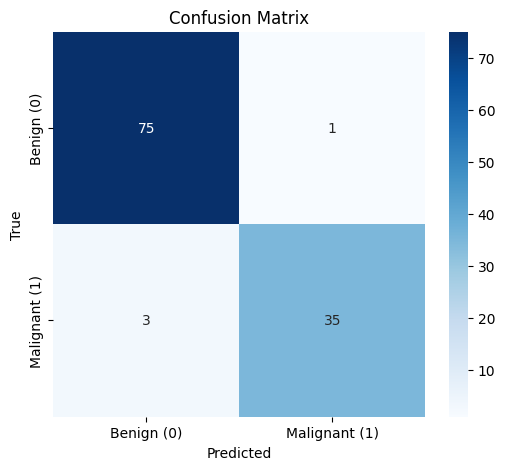

In [19]:
# Confusion matrix on the test data
conf_matrix_test = confusion_matrix(Y_test, Y_test_predict)

print(conf_matrix_test)

# Create a heatmap to visualize the confusion matrix
plt.figure(figsize=(6, 5))
sns.heatmap(conf_matrix_test, annot=True, fmt='d', cmap='Blues', xticklabels=['Benign (0)', 'Malignant (1)'], yticklabels=['Benign (0)', 'Malignant (1)'])

# Set plot labels and title
plt.title('Confusion Matrix')
plt.xlabel('Predicted')
plt.ylabel('True')

# Show the plot
plt.show()

In [20]:
joblib.dump(model, 'brease_cancer_prediction_model.pkl')  # Save the model

['brease_cancer_prediction_model.pkl']

## Test the model on some single data

In [21]:
# taking the data
input_data = (12.68,23.84,82.69,499,0.1122,0.1262,0.1128,0.06873,0.1905,0.0659,0.4255,1.178,2.927,36.46,0.007781,0.02648,0.02973,0.0129,0.01635,0.003601,17.09,33.47,111.8,888.3,0.1851,0.4061,0.4024,0.1716,0.3383,0.1031)
input_data_arr = np.array(input_data)
input_data_arr = input_data_arr.reshape(1, -1)
final_input_data = pd.DataFrame(input_data_arr, columns = X_train.columns)

prediction = model.predict(final_input_data)

# prediction probabilities
probabilities = model.predict_proba(final_input_data)
prob_cancerous = probabilities[0][1]
prob_non_cancerous = probabilities[0][0]

# Display the result along with the confidence
if prediction[0] == 0:
    print(f"This tumor is not cancerous with a confidence of {prob_non_cancerous*100:.2f}%")
else:
    print(f"This tumor is cancerous with a confidence of {prob_cancerous*100:.2f}%")

This tumor is cancerous with a confidence of 99.77%


In [22]:
# Print the coefficients of the model
feature_importance = model.coef_[0]
feature_names = X.columns
feature_importance_dict = {name: coef for name, coef in zip(feature_names, feature_importance)}
sorted_features = sorted(feature_importance_dict.items(), key=lambda x: abs(x[1]), reverse=True)
print("Most important features:")
for feature, coef in sorted_features[:10]:
    print(f"{feature}: {coef}")


Most important features:
concavity_worst: 1.0668814696905795
texture_se: -0.9044742404222863
radius_mean: -0.8180598277826714
symmetry_worst: 0.664735973623466
compactness_worst: 0.5446718024149708
concave points_worst: 0.5106572048565373
concavity_mean: 0.4263065468724576
perimeter_mean: 0.3444192466094438
texture_worst: 0.28983168512108154
smoothness_worst: 0.25220171078432535
